gene expression: normalise + logtransform

# Import modules

In [1]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import numpy as np
import numpy.random as random
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import anndata


import celltypist
from celltypist import models

import sctk
import os

In [2]:
import session_info
session_info.show()

In [3]:
sc.settings.set_figure_params(dpi=120, facecolor='white', color_map = 'RdPu',)

# Function

In [4]:
#>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
# extract rank_genes_groups result 
#>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>

import scanpy as sc
import pandas as pd

def rank_genes_groups_to_df(adata, cell):
    
    dic = adata.uns['rank_genes_groups'] 
    
    df = pd.DataFrame({
        'names' : dic['names'][cell],
        'scores' : dic['scores'][cell],
        'pvals' : dic['pvals'][cell],
        'pvals_adj' : dic['pvals_adj'][cell],
        'logfoldchanges' : dic['logfoldchanges'][cell]
    })
    
    return df

# Read in data

In [5]:
adata = sc.read_h5ad('/home/jovyan/mount/gdrive/Colab/data/scVI/subsets/RNA_foetal_raw_immune_post-scVI_16Feb2023.h5ad')
adata

AnnData object with n_obs × n_vars = 41881 × 31326
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', '_scvi_labels', '2Jan_coarse_grain', '2Jan_mid_grain', '2Jan_fine_grain', 'leiden_scVI', 'FACSgate', 'sex', 'week', 'trimester'
    var: 'gene_name_scRNA-0', 'gene_id', 'n_cells'
    uns: '2Jan_fine_grain_colors', '2Jan_mid_grain_c

# Log-normalise

In [6]:
# normalise and logtransform
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

# Clustering, UMAP

### Deciding resolution

In [7]:
%%time
sc.pp.neighbors(adata, use_rep="X_scVI")
sc.tl.umap(adata, min_dist=0.2, spread=1.0, n_components=3)
sc.tl.leiden(adata, resolution=2, key_added='leiden_scVI')

CPU times: user 1min 45s, sys: 44.8 s, total: 2min 30s
Wall time: 1min 17s


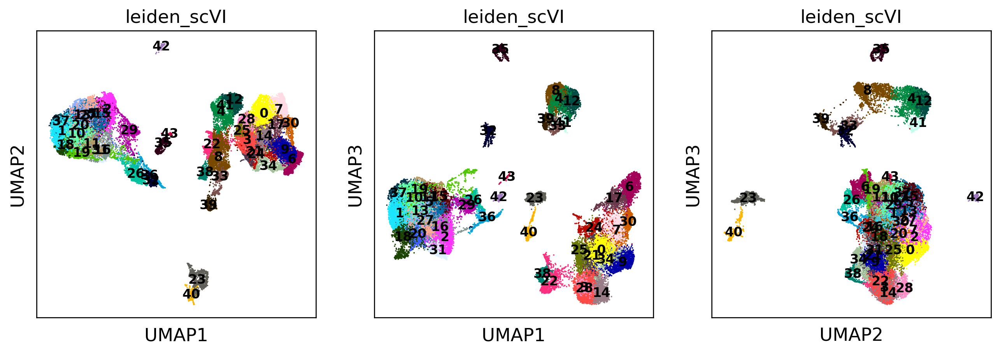

In [12]:
sc.pl.umap(adata, color=['leiden_scVI'], size=5, wspace=0.1, legend_loc='on data', legend_fontsize=10,components='all')

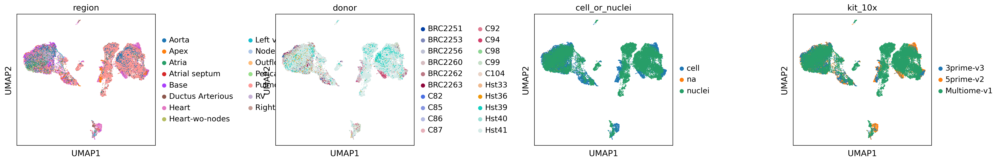

In [13]:
sc.pl.umap(adata, color=['region','donor','cell_or_nuclei','kit_10x'], size=5, wspace=0.7)

In [39]:
pd.crosstab(adata.obs['cell_or_nuclei'],adata.obs['donor']).T

cell_or_nuclei,cell,na,nuclei
donor,,,
BRC2251,392,0,0
BRC2253,0,406,0
BRC2256,914,0,0
BRC2260,2149,0,0
BRC2262,553,0,0
BRC2263,623,0,0
C82,0,0,70
C85,0,0,105
C86,1912,0,0


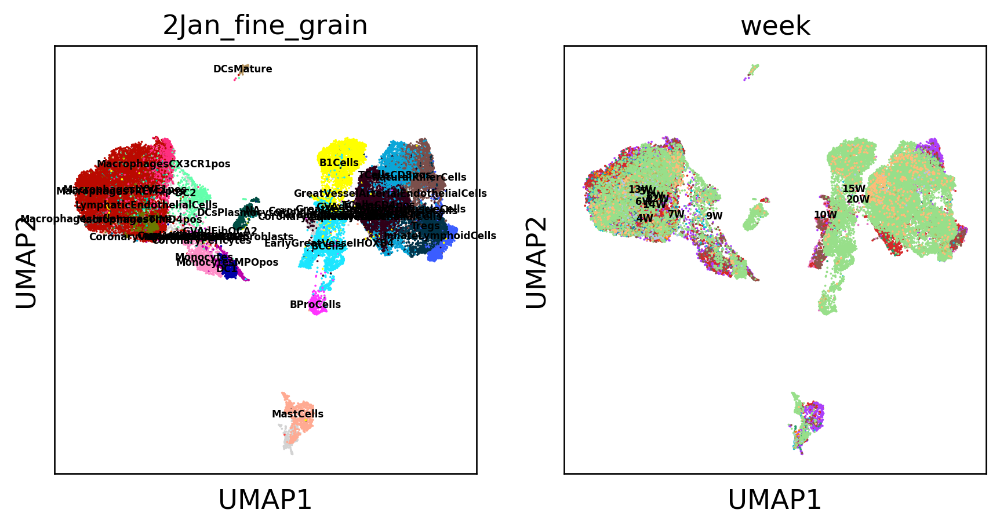

In [14]:
sc.pl.umap(adata, color=['2Jan_fine_grain','week'], size=5, wspace=0.1, legend_loc='on data', legend_fontsize=5)

In [47]:
set(adata.obs['2Jan_fine_grain'])

{'B1Cells',
 'BCells',
 'BProCells',
 'Cardiofibromyocytes',
 'CardiofibromyocytesSecretory',
 'CoronaryCapillaryEndothelialCells',
 'CoronaryPericytes',
 'CoronaryVesselAdventitialFibroblasts',
 'CoronaryVesselSmoothMuscleCells',
 'DC1',
 'DC2',
 'DCsMature',
 'DCsPlasmocytoids',
 'EarlyGreatVesselFLRT2',
 'EarlyGreatVesselHOXB4',
 'EndocardialCells',
 'GVAdFibOCA2',
 'GVAdFibOther',
 'GreatVesselArterialEndothelialCells',
 'GreatVesselSmoothMuscleCells',
 'InnateLymphoidCells',
 'LymphaticEndothelialCells',
 'MacrophagesCX3CR1pos',
 'MacrophagesInflammasome',
 'MacrophagesLYVE1pos',
 'MacrophagesTIMD4pos',
 'MacrophagesTREM2pos',
 'MastCells',
 'Monocytes',
 'MonocytesMPOpos',
 'MyocIntFibROBO2',
 'MyocIntFibSLIT3',
 'Myofibroblasts',
 'NaturalKillerCells',
 'SchwannCells',
 'TCellsCD4pos',
 'TCellsCD8pos',
 'Tregs',
 'ValveOther',
 'ValvePENK',
 nan}

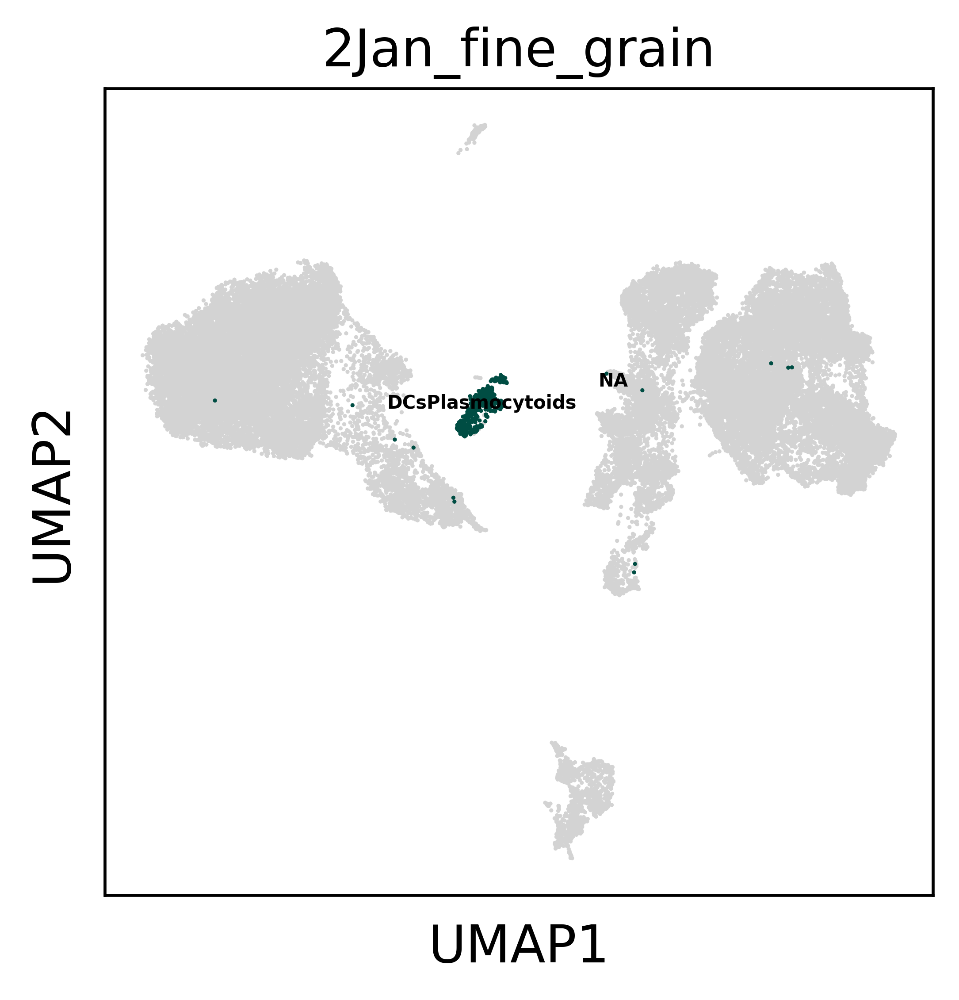

In [48]:
sc.pl.umap(adata, color=['2Jan_fine_grain'], groups='DCsPlasmocytoids', size=5, wspace=0.1, legend_loc='on data', legend_fontsize=5)

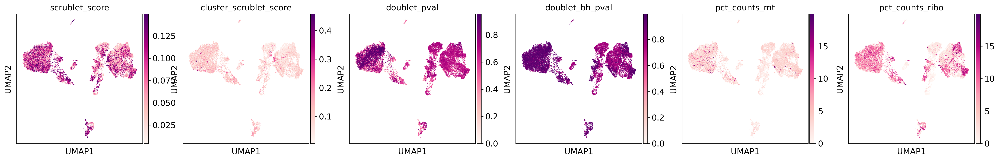

In [15]:
sc.pl.umap(adata, color=['scrublet_score','cluster_scrublet_score','doublet_pval','doublet_bh_pval','pct_counts_mt','pct_counts_ribo'], size=2, wspace=0.2, ncols=6)

# Marker gene expressions

In [ ]:
'''
# set symbol as var_names
adata.var.set_index('gene_name_multiome-1',inplace=True)
adata.var_names = adata.var_names.astype('str')
adata.var_names_make_unique()
'''

         Falling back to preprocessing with `sc.pp.pca` and default params.
categories: 0, 1, 2, etc.
var_group_labels: vCM, aCM, FB, etc.


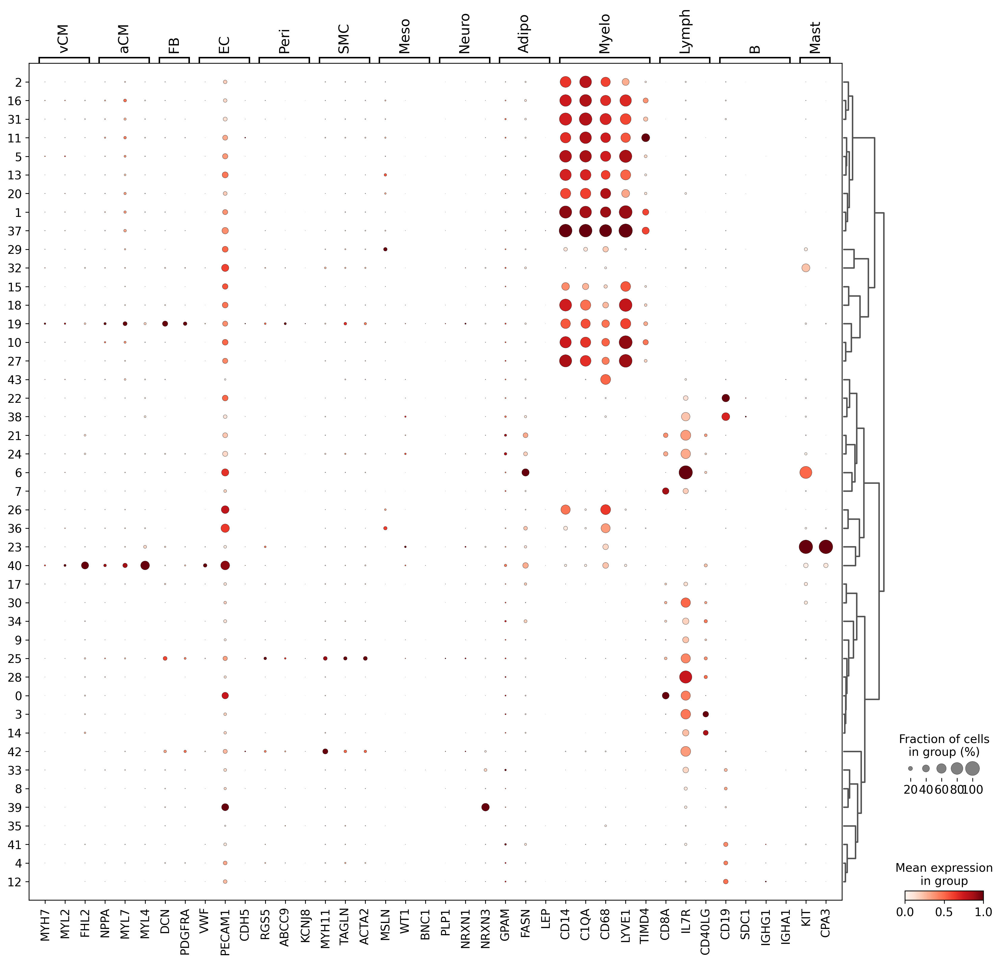

In [18]:
# Checking glabal markers
markers = {
    'vCM': ['MYH7', 'MYL2', 'FHL2'],
    'aCM': ['NPPA', 'MYL7', 'MYL4'],
    'FB': ['DCN', 'GCN', 'PDGFRA'],
    'EC': ['VWF', 'PECAM1', 'CDH5'],
    'Peri': ['RGS5', 'ABCC9', 'KCNJ8'],
    'SMC': ['MYH11', 'TAGLN', 'ACTA2'],
    'Meso': ['MSLN', 'WT1', 'BNC1'],
    'Neuro': ['PLP1', 'NRXN1', 'NRXN3'],
    'Adipo': ['GPAM', 'FASN', 'LEP'],
    'Myelo': ['CD14', 'C1QA', 'CD68','LYVE1','TIMD4'],
    'Lymph': ['CD8A', 'IL7R', 'CD40LG'],
    'B': ['CD19','SDC1','IGHG1','IGHA1'],
    'Mast': ['KIT', 'CPA3'],
}

for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.tl.dendrogram(adata, groupby='leiden_scVI')
sc.pl.dotplot(adata,
              markers, 
              groupby='leiden_scVI',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

categories: 0, 1, 2, etc.
var_group_labels: B cell, T cell, naive, etc.


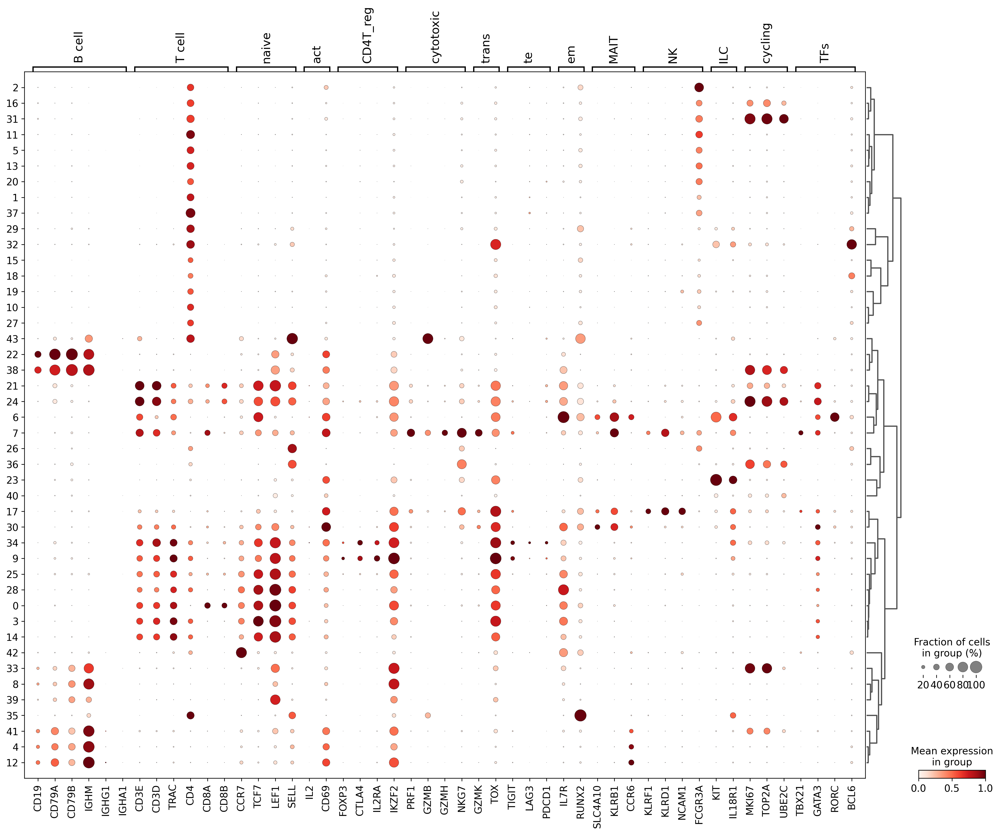

In [19]:
# lymphocytes markers

markers={
    'B cell': ['CD19', 'CD79A', 'CD79B', 'IGHM', 'IGHG1', 'IGHA1'],
    'T cell': ['CD3E', 'CD3D', 'TRAC', 'CD4', 'CD8A', 'CD8B'],
    'naive': ['CCR7', 'TCF7', 'LEF1', 'SELL'],
    'act': ['IL2','CD69'],
    'CD4T_reg': ['FOXP3', 'CTLA4', 'IL2RA', 'IKZF2'],
    'cytotoxic': ['PRF1', 'GZMB', 'GZMH', 'NKG7'],
    'trans': ['GZMK', 'TOX'],
    'te': ['TIGIT', 'LAG3', 'PDCD1'],
    'em': ['IL7R', 'RUNX2'],
    'MAIT': ['SLC4A10', 'KLRB1', 'CCR6'],
    'NK': ['KLRF1', 'KLRD1', 'NCAM1', 'FCGR3A'],
    'ILC': ['KIT', 'IL18R1'],
    'cycling': ['MKI67', 'TOP2A', 'UBE2C'],
    'TFs': ['TBX21', 'GATA3', 'RORC', 'BCL6',],
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata,
              markers, 
              groupby='leiden_scVI',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

categories: 0, 1, 2, etc.
var_group_labels: T cell, naive, cytotoxic, etc.


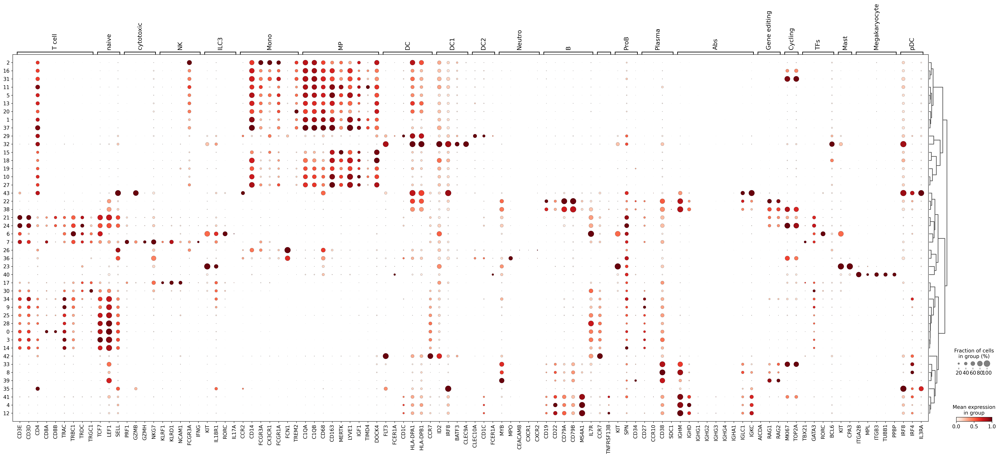

In [20]:
markers={
     'T cell': ['CD3E', 'CD3D','CD4', 'CD8A', 'CD8B','TRAC','TRBC1','TRDC','TRGC1'],
    'naive': ['TCF7', 'LEF1', 'SELL'],
    'cytotoxic': ['PRF1', 'GZMB', 'GZMH', 'NKG7'],
    'NK': ['KLRF1', 'KLRD1', 'NCAM1','FCGR3A','IFNG'],
    'ILC3': ['KIT', 'IL18R1','RORC','IL17A'],
    
    'Mono':['CCR2','CD14','FCGR3A','CX3CR1','FCGR1A','FCN1','TREM2'],
    'MP':['C1QA','C1QB','CD68','CD163','MERTK','LYVE1','IGF1','TIMD4','DOCK4'],
    'DC':['FLT3','FCER1A','CD1C','HLA-DPA1','HLA-DPB1','CCR7'],
    'DC1':['ID2','IRF8','BATF3','CLEC9A'],
    'DC2':['CLEC10A','CD1C','FCER1A',],
    'Neutro':['MYB', 'MPO', 'CEACAM8','CXCR1','CXCR2'],
    
    'B': ['CD19','CD20','CD22','CD79A', 'CD79B','MS4A1','IL7R',],
    '':['CCR7','TNFRSF13B',],
    'ProB':['KIT','SPN','CD34'],
    'Plasma': ['CD27','CCR10','CD38','SDC1','JCAIN'],
    'Abs':['IGHM','IGHD', 'IGHG1','IGHG2', 'IGHG3','IGHG4', 'IGHA1','IGHE','IGLC1','IGKC'],
    'Gene editing': ['AICDA', 'RAG1','RAG2'],
    
    
    'Cycling':['MKI67','TOP2A'],

    'TFs': ['TBX21', 'GATA3', 'RORC', 'BCL6',],
    'Mast': ['KIT', 'CPA3'],
    'Megakaryocyte':['ITGA2B','MPL','ITGB3', 'TUBB1', 'PPBP'],
    'pDC':['IRF8','IRF4','IL3RA']
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata,
              markers, 
              groupby='leiden_scVI',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

In [21]:
sc.settings.set_figure_params(dpi=120, facecolor='white', color_map = 'RdPu',)
sc.pl.umap(adata, color=['CCR2','CD14','FCGR3A','CX3CR1','FCGR1A','FCN1','TREM2',
                'C1QA','C1QB','CD68','CD163','MERTK','LYVE1','IGF1','TIMD4','FOLR2','DOCK4',
                'FLT3','FCER1A','CD1C','HLA-DPA1','HLA-DPB1',
                'CD3D','CD3E','CD4','CD8A','CD8B','CD19','CD19','CD22','CD79A', 'CD79B','MKI67','TOP2A',], size=20, wspace=0.2, ncols=6, components='all')

In [22]:
adata.X.data[:10]

array([0.20843568, 0.38083044, 0.20843568, 0.20843568, 0.20843568,
       0.38083044, 0.38083044, 0.76952875, 0.38083044, 0.38083044],
      dtype=float32)

# DEG analysis

In [23]:
sc.tl.rank_genes_groups(adata, 'leiden_scVI', method='t-test')

DEG_dict = {}
for cluster in adata.obs['leiden_scVI'].cat.categories:
    df=rank_genes_groups_to_df(adata, cluster)
    # select genes: significant and up-regulated ones
    df=df[(df['pvals_adj']<0.05)&(df['logfoldchanges']>0)]
    # sort based on the logFC
    df.sort_values('scores',ascending=False,inplace=True)
    DEG_dict[cluster]=list(df[:5]['names'])
    del df

sc.pl.dotplot(adata,
              DEG_dict, 
              groupby='leiden_scVI',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              swap_axes=False,
             )

In [54]:
# marker of cluster 44
# migratory DC?
DEG_dict = {}
for cluster in adata.obs['leiden_scVI'].cat.categories:
    df=rank_genes_groups_to_df(adata, cluster)
    # select genes: significant and up-regulated ones
    df=df[(df['pvals_adj']<0.05)&(df['logfoldchanges']>0)]
    # sort based on the logFC
    df.sort_values('scores',ascending=False,inplace=True)
    DEG_dict[cluster]=list(df[:50]['names'])
    del df

sc.pl.dotplot(adata,
              DEG_dict['42']+['FLT3','ID2','IRF4','IRF8','CCR7','CIITA','PTPRC'], 
              groupby='leiden_scVI',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              swap_axes=False,
             )

# Annotation 

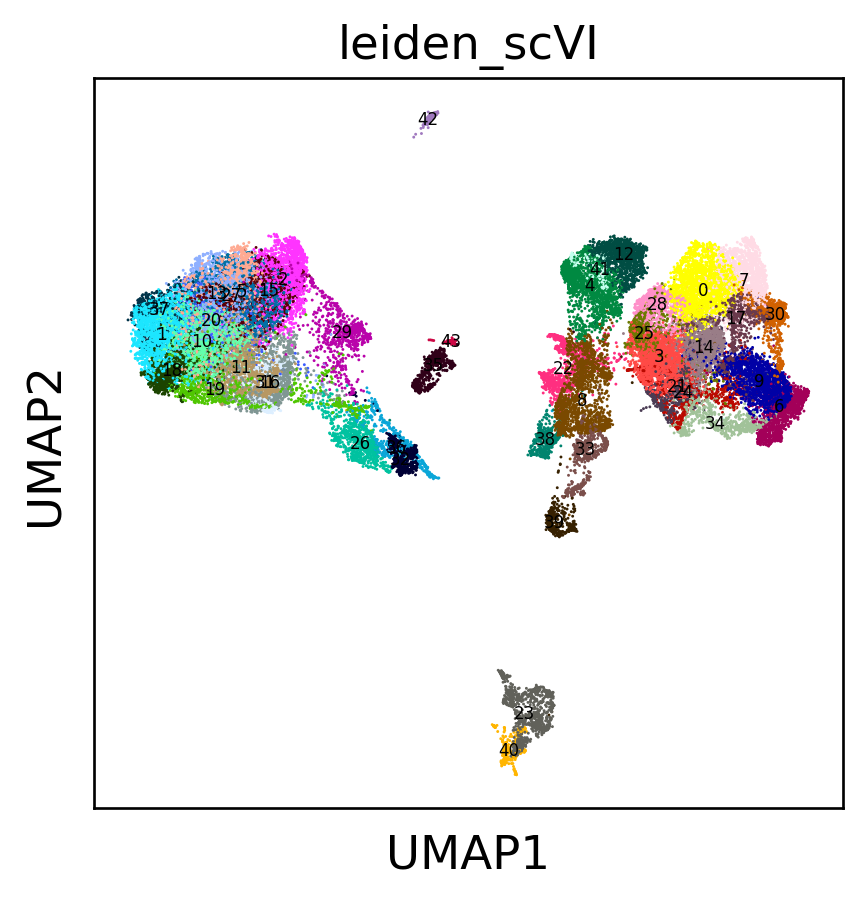

In [69]:
sc.pl.umap(adata, color=['leiden_scVI'], size=3, wspace=0.1, legend_loc='on data', legend_fontsize=5, legend_fontweight='normal')
# components='all',

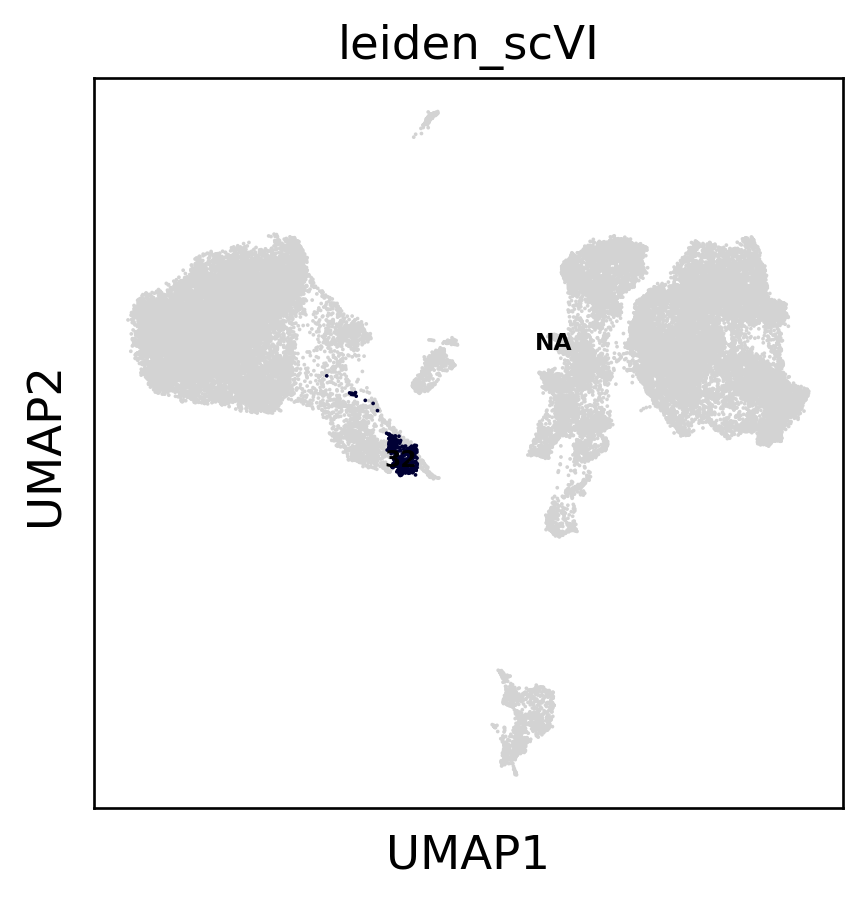

In [70]:
sc.pl.umap(adata, color=['leiden_scVI'], groups=['32'], size=5, wspace=0.1, legend_loc='on data', legend_fontsize=7)

In [66]:
adata.obs['cell_type2']=adata.obs['leiden_scVI'].astype('str').copy()
adata.obs.replace({'cell_type2':{
    '0':'Lymphoid', 
    '1':'Myeloid', 
    '2':'Myeloid', 
    '3':'Lymphoid', 
    '4':'Lymphoid', 
    '5':'Myeloid',  
    '6':'Lymphoid', 
    '7':'Lymphoid',  
    '8':'Lymphoid', 
    '9':'Lymphoid',  
    '10':'Myeloid',  
    '11':'Myeloid',  
    '12':'Lymphoid', 
    '13':'Myeloid', 
    '14':'Lymphoid', 
    '15':'Myeloid', 
    '16':'Myeloid', 
    '17':'Lymphoid', 
    '18':'Myeloid', 
    '19':'Myeloid', 
    '20':'Myeloid', 
    '21':'Lymphoid', 
     '22':'Lymphoid', 
     '23':'Mast cell', 
     '24':'Lymphoid', 
     '25':'Lymphoid', 
     '26':'Myeloid', 
    '27':'Myeloid', 
    '28':'Lymphoid', 
    '29':'Myeloid', 
    '30':'Lymphoid', 
    '31':'Myeloid', 
    '32':'Myeloid', 
    '33':'Lymphoid', 
    '34':'Lymphoid', 
    '35':'Plasmacytoid DC',  
    '36':'Myeloid', 
    '37':'Myeloid', 
    '38':'Lymphoid', 
    '39':'Lymphoid', 
    '40':'Megakaryocyte', 
    '41':'Lymphoid', 
    '42':'DC_mature', 
    '43':'Plasmacytoid DC', 
}}, inplace=True)


adata.obs['cell_type2']=adata.obs['cell_type2'].astype('category')
adata.obs['cell_type2'].cat.reorder_categories([
   'Lymphoid', 
    'Myeloid',
    'Plasmacytoid DC',
    # 'DC1',
    'DC_mature',
    'Megakaryocyte',
     'Mast cell',
    # 'Doublet',
], inplace=True)

adata.obs['cell_type2'].value_counts()

Lymphoid           21336
Myeloid            18527
Mast cell            866
Plasmacytoid DC      608
Megakaryocyte        360
DC_mature            184
Name: cell_type2, dtype: int64

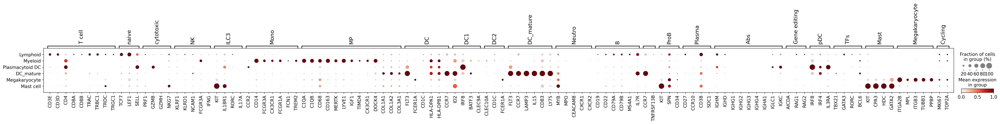

In [71]:
markers={
     'T cell': ['CD3E', 'CD3D','CD4', 'CD8A', 'CD8B','TRAC','TRBC1','TRDC','TRGC1'],
    'naive': ['TCF7', 'LEF1', 'SELL'],
    'cytotoxic': ['PRF1', 'GZMB', 'GZMH', 'NKG7'],
    'NK': ['KLRF1', 'KLRD1', 'NCAM1','FCGR3A','IFNG'],
    'ILC3': ['KIT', 'IL18R1','RORC','IL17A'],
    
    'Mono':['CCR2','CD14','FCGR3A','CX3CR1','FCGR1A','FCN1','TREM2'],
    'MP':['C1QA','C1QB','CD68','CD163','MERTK','LYVE1','IGF1','TIMD4','CX3CR1','DOCK4','COL1A1','COL1A2','COL3A1'],
    'DC':['FLT3','FCER1A','CD1C','HLA-DPA1','HLA-DPB1','CCR7'],
    'DC1':['ID2','IRF8','BATF3','CLEC9A'],
    'DC2':['CLEC10A','CD1C','FCER1A',],
    'DC_mature':['FLT3', 'CCR7','LAMP3', 'IL15', 'CD83', 'LY75', ],
    'Neutro':['MYB', 'MPO', 'CEACAM8','CXCR1','CXCR2'],
    
    'B': ['CD19','CD20','CD22','CD79A', 'CD79B','MS4A1','IL7R',],
    '':['CCR7','TNFRSF13B',],
    'ProB':['KIT','SPN','CD34'],
    'Plasma': ['CD27','CCR10','CD38','SDC1','JCAIN'],
    'Abs':['IGHM','IGHD', 'IGHG1','IGHG2', 'IGHG3','IGHG4', 'IGHA1','IGHE','IGLC1','IGKC'],
    'Gene editing': ['AICDA', 'RAG1','RAG2'],
    
     'pDC':['IRF8','IRF4','IL3RA'],
    
    

    'TFs': ['TBX21', 'GATA3', 'RORC', 'BCL6',],
    'Mast': ['KIT', 'CPA3','HDC','GATA2'],
    'Megakaryocyte':['ITGA2B','MPL','ITGB3', 'TUBB1', 'PPBP'],
    'Cycling':['MKI67','TOP2A'],
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata,
              markers, 
              groupby='cell_type2',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

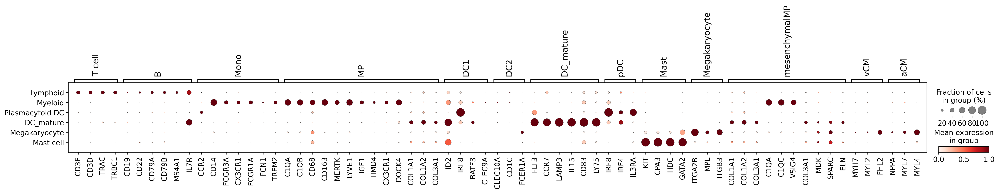

In [72]:
markers={
     'T cell': ['CD3E', 'CD3D','TRAC','TRBC1',],
     'B': ['CD19','CD20','CD22','CD79A', 'CD79B','MS4A1','IL7R',],
   
    
    'Mono':['CCR2','CD14','FCGR3A','CX3CR1','FCGR1A','FCN1','TREM2'],
    'MP':['C1QA','C1QB','CD68','CD163','MERTK','LYVE1','IGF1','TIMD4','CX3CR1','DOCK4','COL1A1','COL1A2','COL3A1'],
    'DC1':['ID2','IRF8','BATF3','CLEC9A'],
    'DC2':['CLEC10A','CD1C','FCER1A',],
     'DC_mature':['FLT3', 'CCR7','LAMP3', 'IL15', 'CD83', 'LY75', ],
    'pDC':['IRF8','IRF4','IL3RA'],
    
   
    'Mast': ['KIT', 'CPA3','HDC','GATA2'],
    'Megakaryocyte':['ITGA2B','MPL','ITGB3',],
    'mesenchymalMP':['COL1A1','COL1A2','COL3A1','C1QA','C1QC','C1QD','VSIG4','COL3A1', 'MDK', 'SPARC', 'ELN'],
    'vCM': ['MYH7', 'MYL2', 'FHL2'],
    'aCM': ['NPPA', 'MYL7', 'MYL4'],
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata,
              markers, 
              groupby='cell_type2',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

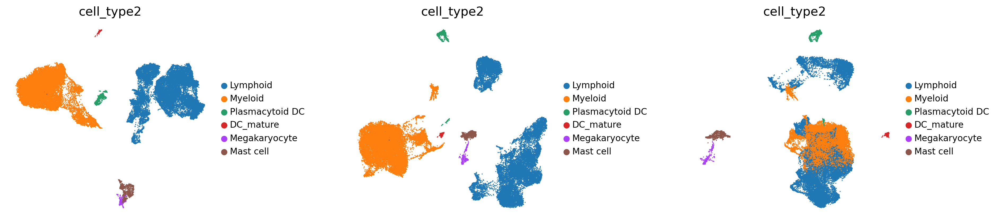

In [73]:
sc.settings.set_figure_params(dpi=120,  color_map = 'RdPu',)
sc.pl.umap(adata, color=['cell_type2'], size=5, legend_fontsize=10, frameon=False, components='all', wspace=0.5)

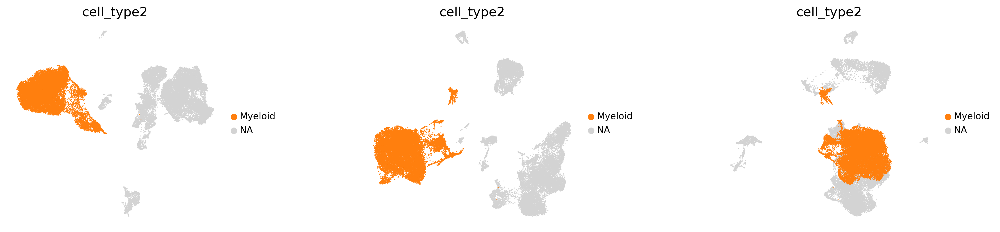

In [74]:
sc.pl.umap(adata, color=['cell_type2'], groups='Myeloid', size=5, legend_fontsize=10, frameon=False, components='all', wspace=0.5)

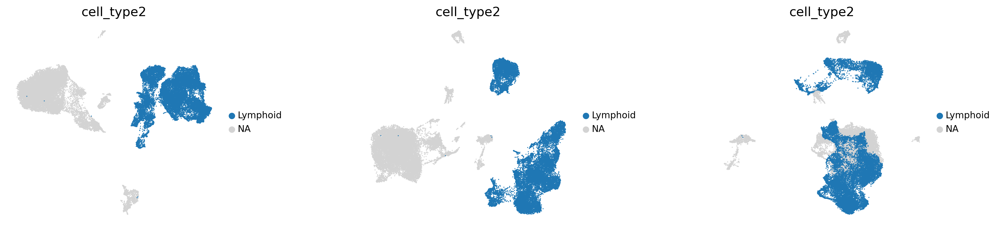

In [75]:
sc.pl.umap(adata, color=['cell_type2'], groups='Lymphoid', size=5, legend_fontsize=10, frameon=False, components='all', wspace=0.5)

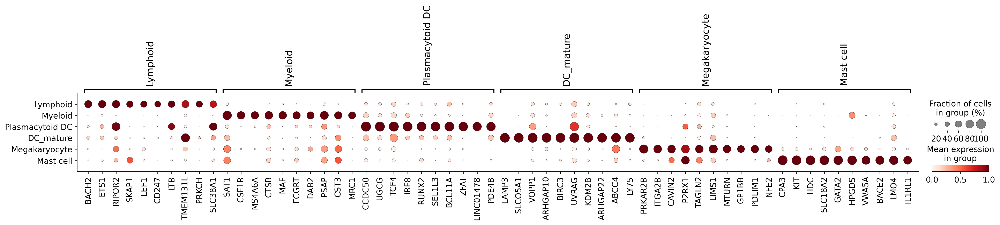

In [76]:
sc.tl.rank_genes_groups(adata, 'cell_type2', method='t-test')

DEG_dict = {}
for cluster in adata.obs['cell_type2'].cat.categories:
    df=rank_genes_groups_to_df(adata, cluster)
    # select genes: significant and up-regulated ones
    df=df[(df['pvals_adj']<0.05)&(df['logfoldchanges']>0)]
    # sort based on the logFC
    df.sort_values('scores',ascending=False,inplace=True)
    DEG_dict[cluster]=list(df[:10]['names'])
    del df

sc.pl.dotplot(adata,
              DEG_dict, 
              groupby='cell_type2',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              swap_axes=False,
             )

# Recover row counts and save

In [78]:
adata_raw=sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/14Feb_fromSemih/14FebImmuneForKazumasa.h5ad')
print(adata_raw.shape)

adata_raw=anndata.AnnData(X=adata_raw[adata.obs_names,:].X,
                      obs=adata.obs, # from annotated or subsetted data
                      var=adata_raw.var,
                      obsm=adata.obsm, # from annotated or subsetted data
                      obsp=adata.obsp # from annotated or subsetted data
                               )
print(adata_raw.shape)

(49042, 36601)
(41881, 36601)


In [82]:
adata_raw.write('/nfs/team205/heart/anndata_objects/Foetal/Immune/RNA_foetal_raw_immune_16Feb2023.h5ad')
adata_raw

AnnData object with n_obs × n_vars = 41881 × 36601
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', '_scvi_labels', '2Jan_coarse_grain', '2Jan_mid_grain', '2Jan_fine_grain', 'leiden_scVI', 'FACSgate', 'sex', 'week', 'trimester', 'cell_type2'
    var: 'gene_name_scRNA-0', 'gene_id'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_contin

In [81]:
# save to gdrive
# update RNA_foetal_raw_immune_16Feb2023.h5ad
adata_raw.write('/home/jovyan/mount/gdrive/Colab/data/anndata/RNA_foetal_raw_immune_16Feb2023.h5ad')

In [ ]:
sc.pl.umap(adata_raw, color=['cell_type2'], size=5, legend_fontsize=10, frameon=False, components='all', wspace=0.5)

In [ ]:
adata_raw.obs['cell_type2'].value_counts()

# Celltypist, pan-foetal immune

In [ ]:
# load model
panfetal_model = models.Model.load('/nfs/team205/kk18/Analysis/celltypist/models/celltypist_model.Pan_Fetal_Human.pkl')

In [ ]:
prediction=celltypist.annotate(adata, model = panfetal_model, majority_voting = False)

In [ ]:
celltypist.dotplot(prediction, use_as_reference = 'cell_type2', use_as_prediction = 'predicted_labels')

In [83]:
adata_pre = sc.read_h5ad('/home/jovyan/mount/gdrive/Colab/data/anndata/RNA_foetal_raw_immune_4Feb2023.h5ad')
adata_pre

AnnData object with n_obs × n_vars = 42624 × 36601
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', '_scvi_labels', '2Jan_coarse_grain', '2Jan_mid_grain', '2Jan_fine_grain', 'leiden_scVI', 'FACSgate', 'immune', 'age_pcw', 'week_pcw', 'cell_type2'
    var: 'gene_name_scRNA-0', 'gene_name_multiome-1'
    uns: 'cell_type2_colors'
  

In [84]:
pd.crosstab(adata_pre.obs['cell_type2'],adata_pre.obs['week_pcw'])

week_pcw,4w,5w,6w,7w,8w,9w,10w,12w,13w,14w,15w,20w
cell_type2,,,,,,,,,,,,
Lymphoid,0,11,122,2249,796,849,1250,22,287,30,640,15580
Myeloid,50,484,784,3094,4266,1349,573,137,1407,121,465,4712
Plasmacytoid DC,0,0,1,11,6,20,51,1,10,0,7,501
DC1,0,1,6,10,39,22,1,4,27,3,15,449
DC_mature,0,0,0,0,2,2,0,0,2,0,4,177
Mast cell,0,0,4,122,285,23,27,2,33,3,7,320
Megakaryocyte,34,21,15,63,150,179,11,6,57,10,2,70
Doublet,7,15,18,45,56,67,9,14,116,28,31,124


In [85]:
pd.crosstab(adata_raw.obs['cell_type2'],adata_raw.obs['week'])

week,4W,5W,6W,7W,8W,9W,10W,12W,13W,14W,15W,20W
cell_type2,,,,,,,,,,,,
Lymphoid,1,5,125,1872,784,827,1248,24,185,30,607,15628
Myeloid,52,498,807,3151,4328,1426,580,155,1011,165,414,5940
Plasmacytoid DC,0,0,1,11,3,19,50,1,7,0,8,508
DC_mature,0,0,0,0,3,2,0,0,1,0,3,175
Megakaryocyte,4,17,19,48,150,22,12,7,32,11,1,37
Mast cell,0,0,7,127,295,28,22,1,25,1,5,355
